In [7]:
!pip install plotly-geo
import plotly.express as px

from plotly.offline import plot, iplot, init_notebook_mode
import plotly.figure_factory as ff
init_notebook_mode(connected=True)
import pandas as pd
import numpy as np

In [13]:
df = pd.read_csv("https://raw.githubusercontent.com/benvictoria17/DataAnalytics/main/dataset/New%20York%20Times%20-%20COVID-19%20Dataset/us-states.csv")
print(df.head(5))
fip = pd.read_csv("https://raw.githubusercontent.com/benvictoria17/DataAnalytics/main/dataset/state-fips/state_fips.csv")
fip = fip.loc[:, ["state_name","state_abbr","fips"]]
print(fip.head(5))

         date       state  fips  cases  deaths
0  2020-01-21  Washington    53      1       0
1  2020-01-22  Washington    53      1       0
2  2020-01-23  Washington    53      1       0
3  2020-01-24    Illinois    17      1       0
4  2020-01-24  Washington    53      1       0
   state_name state_abbr  fips
0     Alabama         AL     1
1      Alaska         AK     2
2     Arizona         AZ     4
3    Arkansas         AR     5
4  California         CA     6


In [16]:
df_state_avg = pd.read_csv("https://raw.githubusercontent.com/benvictoria17/DataAnalytics/main/dataset/New%20York%20Times%20-%20COVID-19%20Dataset/us-states_1.csv")
print(df_state_avg.head(5))

         date   geoid       state  cases  cases_avg  cases_avg_per_100k  \
0  2020-01-21  USA-53  Washington      1       0.14                 0.0   
1  2020-01-22  USA-53  Washington      0       0.14                 0.0   
2  2020-01-23  USA-53  Washington      0       0.14                 0.0   
3  2020-01-24  USA-53  Washington      0       0.14                 0.0   
4  2020-01-24  USA-17    Illinois      1       0.14                 0.0   

   deaths  deaths_avg  deaths_avg_per_100k  
0       0         0.0                  0.0  
1       0         0.0                  0.0  
2       0         0.0                  0.0  
3       0         0.0                  0.0  
4       0         0.0                  0.0  


In [20]:
df_national_avg = pd.read_csv("https://raw.githubusercontent.com/benvictoria17/DataAnalytics/main/dataset/New%20York%20Times%20-%20COVID-19%20Dataset/us.csv")
print(df_national_avg.tail(10))

           date geoid   cases  cases_avg  cases_avg_per_100k  deaths  \
765  2022-02-24   USA   73391   72687.52               21.91    2908   
766  2022-02-25   USA   85986   68660.87               20.69    2809   
767  2022-02-26   USA   25210   66441.42               20.02     565   
768  2022-02-27   USA    9086   65761.86               19.82     197   
769  2022-02-28   USA  107799   64293.60               19.38    1972   
770  2022-03-01   USA   47426   59050.99               17.80    1933   
771  2022-03-02   USA   58023   54733.64               16.50    2346   
772  2022-03-03   USA   51708   51598.56               15.55    1882   
773  2022-03-04   USA   50139   46928.27               14.14    1892   
774  2022-03-05   USA   16496   45818.50               13.81     307   

     deaths_avg  deaths_avg_per_100k  
765     1868.12                 0.56  
766     1897.54                 0.57  
767     1871.60                 0.56  
768     1876.32                 0.57  
769     1855

In [21]:
def fig_layout():
    fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     step="day",
                     stepmode="backward"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
    )
)

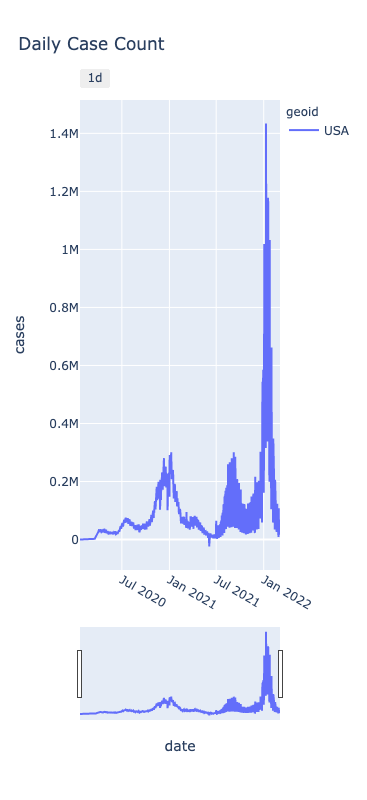

In [22]:
fig = px.line(df_national_avg, x="date", y="cases", color='geoid', height=800, width=1200, title="Daily Case Count" )
fig_layout()
fig.show()

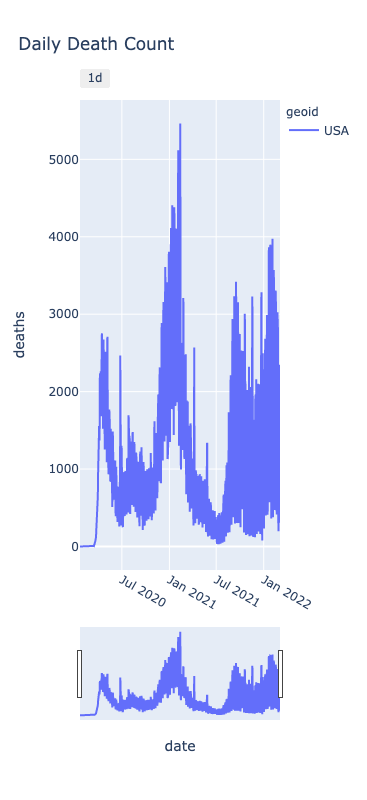

In [23]:
fig = px.line(df_national_avg, x="date", y="deaths", color='geoid', height=800, width=1200, title="Daily Death Count")
fig_layout()
fig.show()

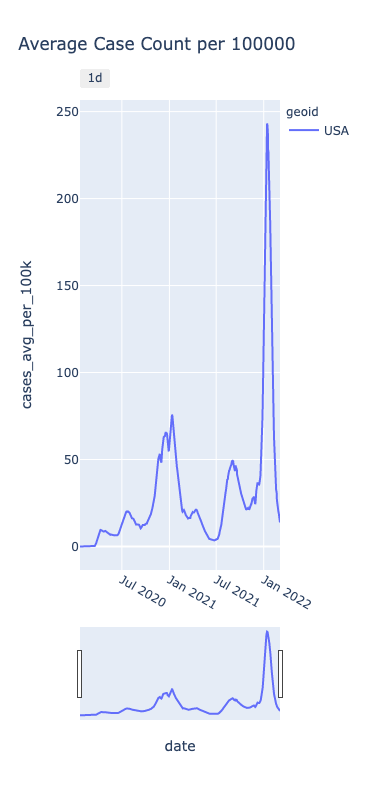

In [24]:
fig = px.line(df_national_avg, x="date", y="cases_avg_per_100k", color='geoid', height=800, width=1200,title="Average Case Count per 100000")
fig_layout()
fig.show()

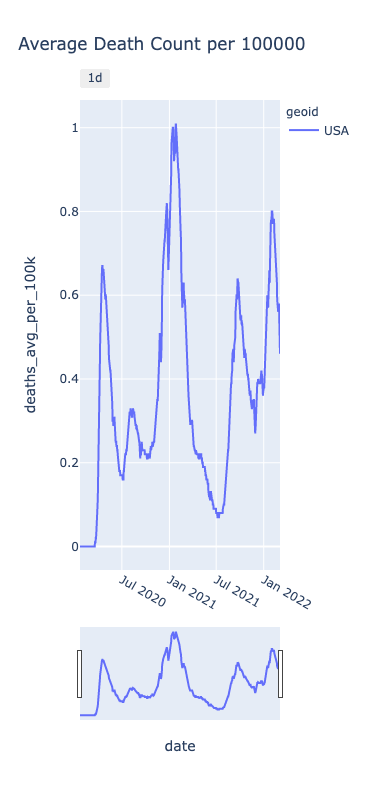

In [25]:
fig = px.line(df_national_avg, x="date", y="deaths_avg_per_100k", color='geoid', height=800, width=1200, title="Average Death Count per 100000")
fig_layout()
fig.show()

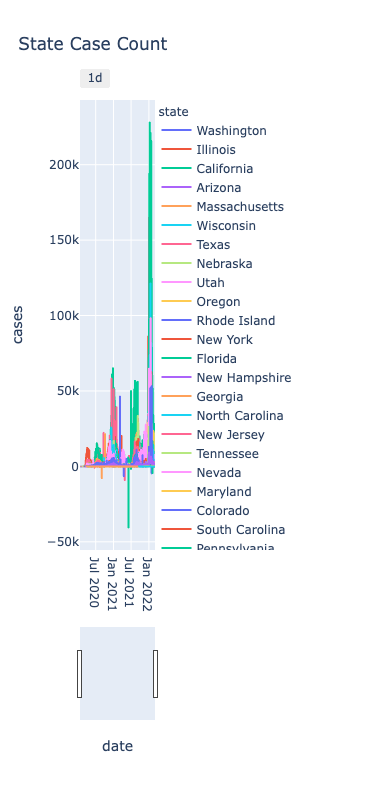

In [26]:
fig = px.line(df_state_avg, x="date", y="cases", color='state', height=800, width=1200, title="State Case Count")
fig_layout()
fig.show()

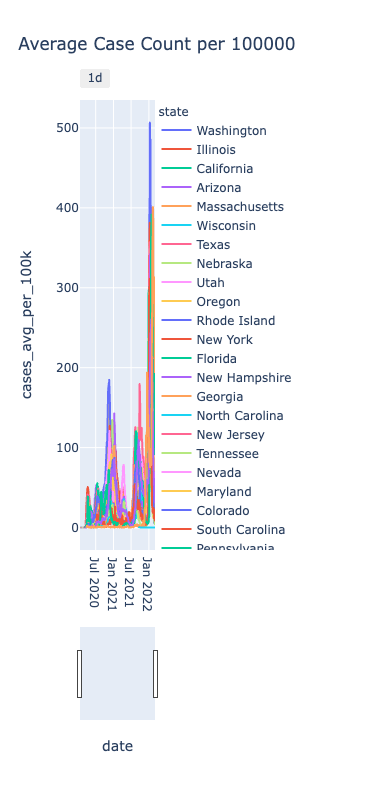

In [27]:
fig = px.line(df_state_avg, x="date", y="cases_avg_per_100k", color='state', height=800, width=1200, title="Average Case Count per 100000")
fig_layout()
fig.show()

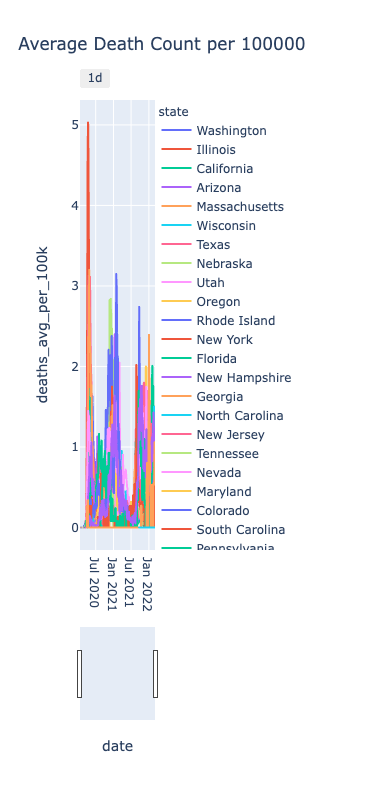

In [28]:
fig = px.line(df_state_avg, x="date", y="deaths_avg_per_100k", color='state', height=800, width=1200, title="Average Death Count per 100000")
fig_layout()
fig.show()

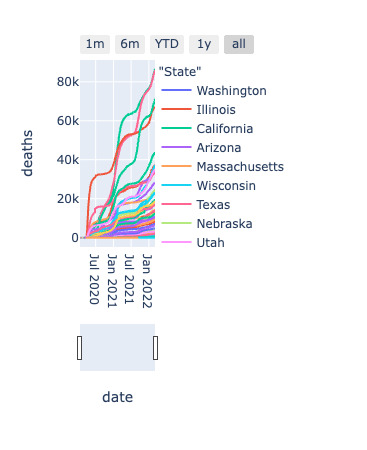

In [29]:
fig = px.line(df.sort_values(by=['date'], ascending=[True]), x='date', y='cases', color='state', hover_name='state')
fig = px.line(df.sort_values(by=['date'], ascending=[True]), x='date', y='deaths', color='state', hover_name='state')
fig.update_layout(legend_title_text='"State"')
fig.update_layout(xaxis_rangeslider_visible=True)
fig.update_layout(xaxis_rangeselector_buttons=list([
                dict(label="1m", count=1, step="month", stepmode="backward"),
                dict(label="6m", count=6, step="month", stepmode="backward"),
                dict(label="YTD", count=1, step="year", stepmode="todate"),
                dict(label="1y", count=1, step="year", stepmode="backward"),
                dict(step="all")
            ]))
fig

In [33]:
dfcr = pd.read_csv("https://raw.githubusercontent.com/benvictoria17/DataAnalytics/main/dataset/New%20York%20Times%20-%20COVID-19%20Dataset/us-counties-recent.csv")
print(dfcr.head(5))
dfcr.isnull().sum()
dfcr["fips"] = dfcr["fips"].fillna(value=dfcr["fips"].mean())
dfcr.isnull().sum()
dfcr = pd.merge(dfcr, fip, how='left', left_on='state', right_on='state_name')
print(dfcr.head(5))

         date   county    state    fips  cases  deaths
0  2022-02-04  Autauga  Alabama  1001.0  14970   170.0
1  2022-02-04  Baldwin  Alabama  1003.0  53559   623.0
2  2022-02-04  Barbour  Alabama  1005.0   5338    85.0
3  2022-02-04     Bibb  Alabama  1007.0   6204    96.0
4  2022-02-04   Blount  Alabama  1009.0  14299   210.0
         date   county    state  fips_x  cases  deaths state_name state_abbr  \
0  2022-02-04  Autauga  Alabama  1001.0  14970   170.0    Alabama         AL   
1  2022-02-04  Baldwin  Alabama  1003.0  53559   623.0    Alabama         AL   
2  2022-02-04  Barbour  Alabama  1005.0   5338    85.0    Alabama         AL   
3  2022-02-04     Bibb  Alabama  1007.0   6204    96.0    Alabama         AL   
4  2022-02-04   Blount  Alabama  1009.0  14299   210.0    Alabama         AL   

   fips_y  
0     1.0  
1     1.0  
2     1.0  
3     1.0  
4     1.0  


In [35]:
dfc = pd.read_csv("https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-counties.csv")
print(dfc.head(5))
dfc.isnull().sum()
dfc["fips"] = dfc["fips"].fillna(value=dfc["fips"].mean())
dfc.isnull().sum()

         date     county       state     fips  cases  deaths
0  2020-01-21  Snohomish  Washington  53061.0      1     0.0
1  2020-01-22  Snohomish  Washington  53061.0      1     0.0
2  2020-01-23  Snohomish  Washington  53061.0      1     0.0
3  2020-01-24       Cook    Illinois  17031.0      1     0.0
4  2020-01-24  Snohomish  Washington  53061.0      1     0.0


date          0
county        0
state         0
fips          0
cases         0
deaths    57605
dtype: int64

In [36]:
df.isnull().sum()
df["fips_x"] = df["fips"].fillna(value=df["fips"].mean())
df.isnull().sum()

date      0
state     0
fips      0
cases     0
deaths    0
fips_x    0
dtype: int64

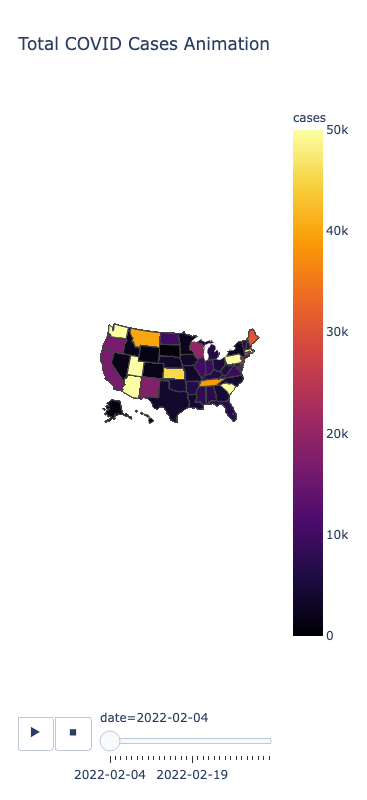

In [37]:
px.choropleth(dfcr, 
              locations = 'state_abbr',
              color="cases", 
              animation_frame="date",
              color_continuous_scale="Inferno",
              locationmode='USA-states',
              scope="usa",height=800, width=1200,
              range_color=(0, 50000),
              title='Total COVID Cases Animation',
             )

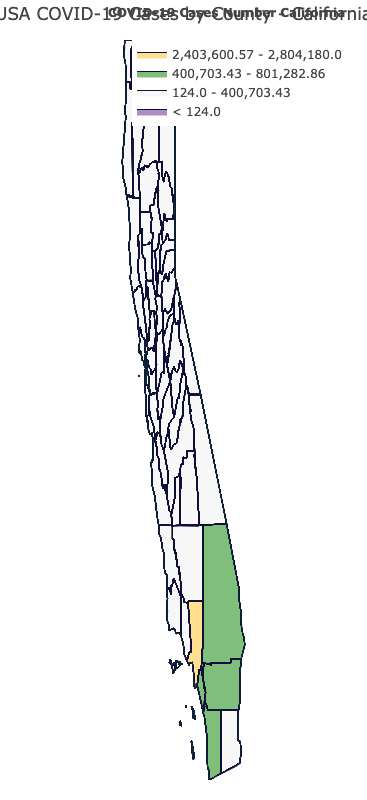

California
Done
------------------------------


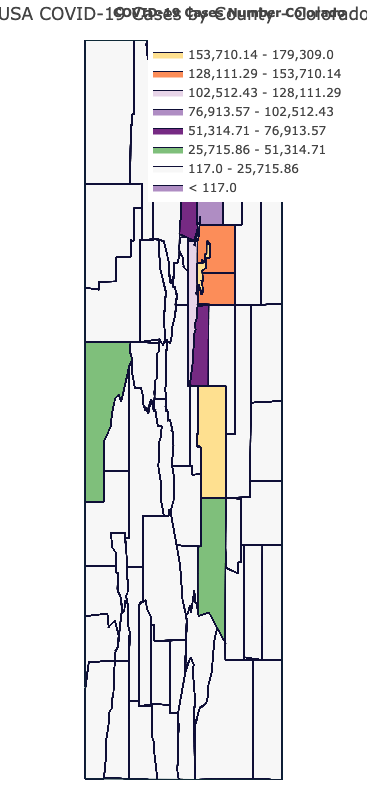

Colorado
Done
------------------------------


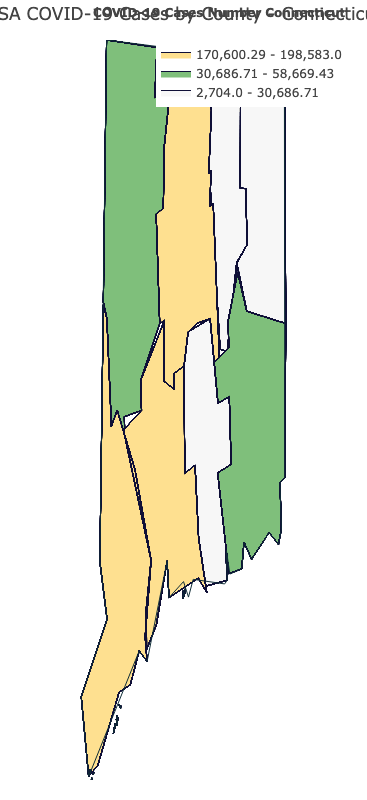

Connecticut
Done
------------------------------


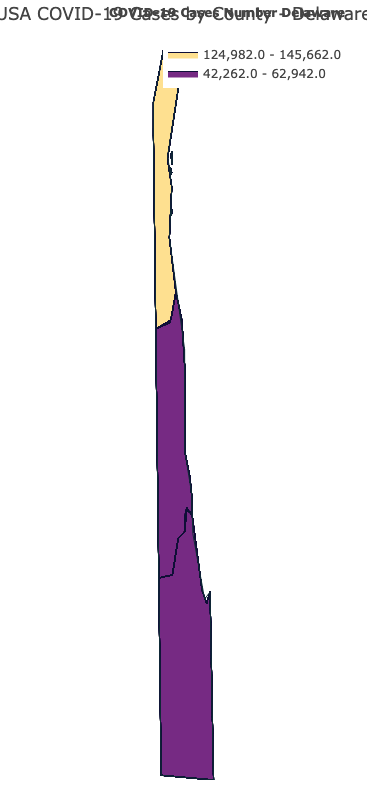

Delaware
Done
------------------------------


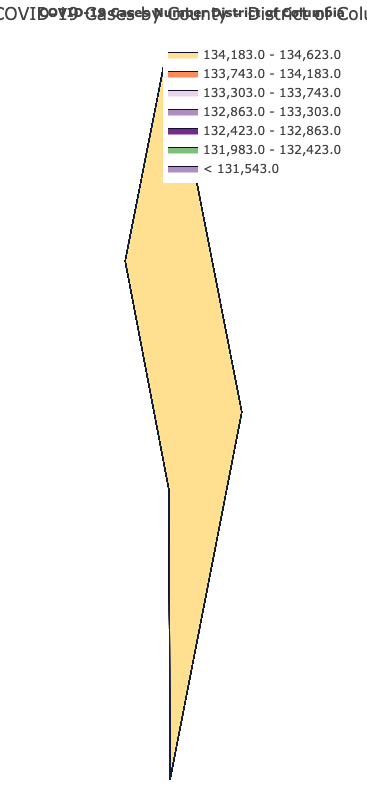

District of Columbia
Done
------------------------------


In [38]:
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")

colorscale = [
    'rgb(175,141,195)',
    'rgb(247,247,247)',
    'rgb(127,191,123)',
    'rgb(118,42,131)',
    'rgb(175,141,195)',
    'rgb(231,212,232)',
    'rgb(252,141,89)',
    'rgb(254,224,144)',
    'rgb(224,243,248)',
    'rgb(145,191,219)',
    'rgb(69,117,180)',
    'rgb(166,206,227)',
    'rgb(31,120,180)',
    'rgb(178,223,138)'
]

    

uniquelist = dfcr.state.unique()
for state in uniquelist[5:10]:
    dfcr_st = dfcr[dfcr['state'] == state]
    dfcr_st['fips_x'] = dfcr_st['fips_x'].astype(int)
    dfcr_st['fips_x'] = dfcr_st['fips_x'].astype(str)
    fips = dfcr_st['fips_x'].tolist()
    values = dfcr_st['cases'].astype(int).tolist()
    endpts = list(np.mgrid[min(values):max(values):8j])
    title='USA COVID-19 Cases by County - ' + state
    legend_title = 'COVID-19 Cases Number ' + state
    fig = ff.create_choropleth(
        fips=fips, values=values,
        binning_endpoints=endpts,
        scope=[state],
        colorscale=colorscale,
        height=800, width=1200,
        county_outline={'color': 'rgb(15,15,55)', 'width': 1},
        state_outline={'color': 'rgb(15,45,55)', 'width': 1},
        show_state_data=True,
        show_hover=True, 
        centroid_marker={'opacity': 0},
        asp=2.9, 
        title=title,
        legend_title=legend_title,
    )
    fig.layout.template = None
    fig.show()
    print(state)
    print('Done')
    print('-'*30)

In [40]:
!pip install pyviz dask

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
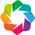

In [41]:
import holoviews as hv
import holoviews as hv
hv.__version__
hv.extension('bokeh', 'geoviews')